## 데이터 관찰

- 100x100x3 크기의 사과 이미지 127개, 체리 이미지 127개, 토마토 50개
- 사과와 체리의 특징이 사전학습시 모델에 반영되었을 것으로 예상
- 토마토를 구별할 수 있는 특징은 모델에 반영되지 않았을 것으로 예상되지만 상대적으로 소수의 데이터
- 세가지 클래스 모두 유사한 색상을 가지므로 색상 정보는 분류 특징으로 적합하지 않아보임
- 흰색 배경과 물체의 경계가 뚜렷하므로 세개 클래스의 외형(shape), 사과의 스티커, 사과의 텍스쳐등을 학습하여 구분할것으로 예상
- 학습에 어려움이 있을 경우, fine-grained classification 또는 few-shot learning 서치 예상
- 시계방향 또는 반시계방향의 회전 데이터 증강은 필요 없어보임
- 사전학습된 모델은 제공된 사과와 체리 클래스를 잘 구분하고있음

## 실험 계획

- 이미 사과와 체리에 대한 구분 능력이 있으므로 conv-bn-silu-pool 블록들은 freeze 하고 말단에 레이어를 추가
- 매우 적은양의 데이터를 이용한 전이학습이므로 작은 크기의 레이어 추가, 작은 learning rate 적용
  - 1: FC 레이어 1개, cross entropy
  - 2: FC 레이어 2개와 skip connection, cross entropy
- 사과와 체리의 구분은 이미 쉬우며 더 많은 데이터가 있으므로 구분이 어려운 클래스의 학습 효과를 높이기 위해 focal loss 적용
  - 3: FC 레이어 1개, focal loss
  - 4: FC 레이어 2개와 skip connection, focal loss
- 소수의 데이터지만 7:2:1 비율로 train, validation, test 데이터 구분
- ground truth와 추론 결과의 confusion matrix로 성능평가
- grad-cam 시각화로 conv3의 gradient와 activation이 추론에 기여한 부분 확인

### model.py, ConvNet

In [1]:
import torch
from torch import nn

class ConvNet(nn.Module):
    def __init__(self, num_classes=5):
        super(ConvNet, self).__init__()

        self.conv1 = nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(16)
        
        self.conv2 = nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(32)
        
        self.conv3 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.bn3 = nn.BatchNorm2d(64)

        self.fc = nn.Linear(64 * 8 * 8, num_classes)
        
        self.pool = nn.MaxPool2d(2)
        
        self.act = nn.SiLU()

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.act(x)
        x = self.pool(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.act(x)
        x = self.pool(x)

        x = self.conv3(x)
        x = self.bn3(x)
        x = self.act(x)
        x = self.pool(x)

        x = x.reshape(x.size(0), -1)

        x = self.fc(x)

        return x

### 2, 4 모델을 위한 전이학습 블록

In [2]:
class AdapterBlock(nn.Module):
    def __init__(self, in_features=64 * 8 * 8, reduction=16, num_classes=5):
        super().__init__()
        self.adapter = nn.Sequential(
            nn.Linear(in_features, in_features // reduction),
            nn.ReLU(inplace=True),
            nn.Linear(in_features // reduction, in_features),
            nn.ReLU(inplace=True)
        )
        self.classifier = nn.Linear(in_features, num_classes)

    def forward(self, x):
        x = self.adapter(x) + x  # residual connection
        return self.classifier(x)

### Focal Loss

In [3]:
class FocalLoss(nn.Module):
    def __init__(self, alpha=1, gamma=2):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.ce = nn.CrossEntropyLoss()

    def forward(self, inputs, targets):
        ce_loss = self.ce(inputs, targets)
        pt = torch.exp(-ce_loss)
        focal_loss = self.alpha * (1 - pt) ** self.gamma * ce_loss
        return focal_loss

### 학습 함수

In [4]:
def train_model(model, train_loader, val_loader, loss_fn, strategy_name, num_epochs=20):
    model.to(device)
    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.0005)

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0
        for imgs, labels in train_loader:
            imgs, labels = imgs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(imgs)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        # Validation
        model.eval()
        correct, total = 0, 0
        with torch.no_grad():
            for imgs, labels in val_loader:
                imgs, labels = imgs.to(device), labels.to(device)
                outputs = model(imgs)
                _, preds = torch.max(outputs, 1)
                correct += (preds == labels).sum().item()
                total += labels.size(0)

        acc = correct / total
        print(f"[{strategy_name}] Epoch {epoch+1}: Loss={total_loss:.4f}, ValAcc={acc:.4f}")

    return model

### 평가 함수

In [5]:
from sklearn.metrics import classification_report
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

def evaluate(model, loader, title='Test'):
    model.eval()
    y_true, y_pred = [], []
    with torch.no_grad():
        for imgs, labels in loader:
            imgs = imgs.to(device)
            outputs = model(imgs)
            _, preds = torch.max(outputs, 1)
            y_true.extend(labels.cpu().numpy())
            y_pred.extend(preds.cpu().numpy())

    print(f"\n [{title} Set Evaluation]")
    print(classification_report(y_true, y_pred, target_names=class_names))

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'{title} Set - Confusion Matrix')
    plt.tight_layout()
    plt.show()

### 데이터 로딩, 전처리

In [6]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split

data_dir = 'data/train'

transform_train = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(),
    transforms.RandomErasing(p=0.5, scale=(0.02, 0.2)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

transform_eval = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

def is_valid_file(path):
    return '.ipynb_checkpoints' not in path and path.lower().endswith(('.jpg', '.jpeg', '.png'))
    
full_dataset = datasets.ImageFolder(root=data_dir, transform=None, is_valid_file=is_valid_file)
class_names = full_dataset.classes
num_classes = len(class_names)

n = len(full_dataset)
n_train, n_val, n_test = int(0.7*n), int(0.2*n), n - int(0.7*n) - int(0.2*n)
train_set, val_set, test_set = random_split(full_dataset, [n_train, n_val, n_test])

train_set.dataset.transform = transform_train
val_set.dataset.transform = transform_eval
test_set.dataset.transform = transform_eval

train_loader = DataLoader(train_set, batch_size=32, shuffle=True)
val_loader = DataLoader(val_set, batch_size=32)
test_loader = DataLoader(test_set, batch_size=32)

### 모델 정의 및 학습

In [7]:
import torch.optim as optim

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# model1: FC fine-tune + CrossEntropy
model1 = ConvNet(num_classes=5)
model1.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model1.conv1.parameters(): param.requires_grad = False
for param in model1.conv2.parameters(): param.requires_grad = False
for param in model1.conv3.parameters(): param.requires_grad = False
model1.fc = nn.Linear(64 * 8 * 8, num_classes)
model1 = train_model(model1, train_loader, val_loader, nn.CrossEntropyLoss(), strategy_name='Base-CE')

# model2: FC fine-tune + Focal Loss
model2 = ConvNet(num_classes=5)
model2.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model2.conv1.parameters(): param.requires_grad = False
for param in model2.conv2.parameters(): param.requires_grad = False
for param in model2.conv3.parameters(): param.requires_grad = False
model2.fc = nn.Linear(64 * 8 * 8, num_classes)
model2 = train_model(model2, train_loader, val_loader, FocalLoss(), strategy_name='Base-Focal')

# model3: AdapterBlock + CrossEntropy
model3 = ConvNet(num_classes=5)
model3.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model3.conv1.parameters(): param.requires_grad = False
for param in model3.conv2.parameters(): param.requires_grad = False
for param in model3.conv3.parameters(): param.requires_grad = False
model3.fc = AdapterBlock(in_features=64 * 8 * 8, reduction=16, num_classes=num_classes)
model3 = train_model(model3, train_loader, val_loader, nn.CrossEntropyLoss(), strategy_name='Adapter-CE')

# model4: AdapterBlock + Focal Loss
model4 = ConvNet(num_classes=5)
model4.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model4.conv1.parameters(): param.requires_grad = False
for param in model4.conv2.parameters(): param.requires_grad = False
for param in model4.conv3.parameters(): param.requires_grad = False
model4.fc = AdapterBlock(in_features=64 * 8 * 8, reduction=16, num_classes=num_classes)
model4 = train_model(model4, train_loader, val_loader, FocalLoss(), strategy_name='Adapter-Focal')


/tmp/ipykernel_3141878/3376114783.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load("conv_net.pth", map_location=device))


[Base-CE] Epoch 1: Loss=2.4913, ValAcc=1.0000
[Base-CE] Epoch 2: Loss=0.0898, ValAcc=1.0000
[Base-CE] Epoch 3: Loss=0.0176, ValAcc=1.0000
[Base-CE] Epoch 4: Loss=0.0083, ValAcc=1.0000
[Base-CE] Epoch 5: Loss=0.0061, ValAcc=1.0000
[Base-CE] Epoch 6: Loss=0.0031, ValAcc=1.0000
[Base-CE] Epoch 7: Loss=0.0036, ValAcc=1.0000
[Base-CE] Epoch 8: Loss=0.0042, ValAcc=1.0000
[Base-CE] Epoch 9: Loss=0.0023, ValAcc=1.0000
[Base-CE] Epoch 10: Loss=0.0021, ValAcc=1.0000
[Base-CE] Epoch 11: Loss=0.0028, ValAcc=1.0000
[Base-CE] Epoch 12: Loss=0.0025, ValAcc=1.0000
[Base-CE] Epoch 13: Loss=0.0028, ValAcc=1.0000
[Base-CE] Epoch 14: Loss=0.0019, ValAcc=1.0000
[Base-CE] Epoch 15: Loss=0.0019, ValAcc=1.0000
[Base-CE] Epoch 16: Loss=0.0024, ValAcc=1.0000
[Base-CE] Epoch 17: Loss=0.0023, ValAcc=1.0000
[Base-CE] Epoch 18: Loss=0.0023, ValAcc=1.0000
[Base-CE] Epoch 19: Loss=0.0018, ValAcc=1.0000
[Base-CE] Epoch 20: Loss=0.0022, ValAcc=1.0000


/tmp/ipykernel_3141878/3376114783.py:16: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load("conv_net.pth", map_location=device))


[Base-Focal] Epoch 1: Loss=1.1855, ValAcc=1.0000
[Base-Focal] Epoch 2: Loss=0.0028, ValAcc=1.0000
[Base-Focal] Epoch 3: Loss=0.0002, ValAcc=1.0000
[Base-Focal] Epoch 4: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 5: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 6: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 7: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 8: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 9: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 10: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 11: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 12: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 13: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 14: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 15: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 16: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 17: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 18: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 19: Loss=0.0000, ValAcc=1.0000
[Base-Focal] Epoch 20: Loss=0.0000, ValAcc=1.0000


/tmp/ipykernel_3141878/3376114783.py:25: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model3.load_state_dict(torch.load("conv_net.pth", map_location=device))


[Adapter-CE] Epoch 1: Loss=3.4651, ValAcc=1.0000
[Adapter-CE] Epoch 2: Loss=0.0203, ValAcc=1.0000
[Adapter-CE] Epoch 3: Loss=0.0001, ValAcc=1.0000
[Adapter-CE] Epoch 4: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 5: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 6: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 7: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 8: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 9: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 10: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 11: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 12: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 13: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 14: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 15: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 16: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 17: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 18: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 19: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 20: Loss=0.0000, ValAcc=1.0000


/tmp/ipykernel_3141878/3376114783.py:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model4.load_state_dict(torch.load("conv_net.pth", map_location=device))


[Adapter-Focal] Epoch 1: Loss=0.8900, ValAcc=1.0000
[Adapter-Focal] Epoch 2: Loss=0.0007, ValAcc=1.0000
[Adapter-Focal] Epoch 3: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 4: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 5: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 6: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 7: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 8: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 9: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 10: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 11: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 12: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 13: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 14: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 15: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 16: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 17: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 18: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 19: Loss=0.0000, ValAcc=1.0000
[A

### 모델 평가


 [Base-CE Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



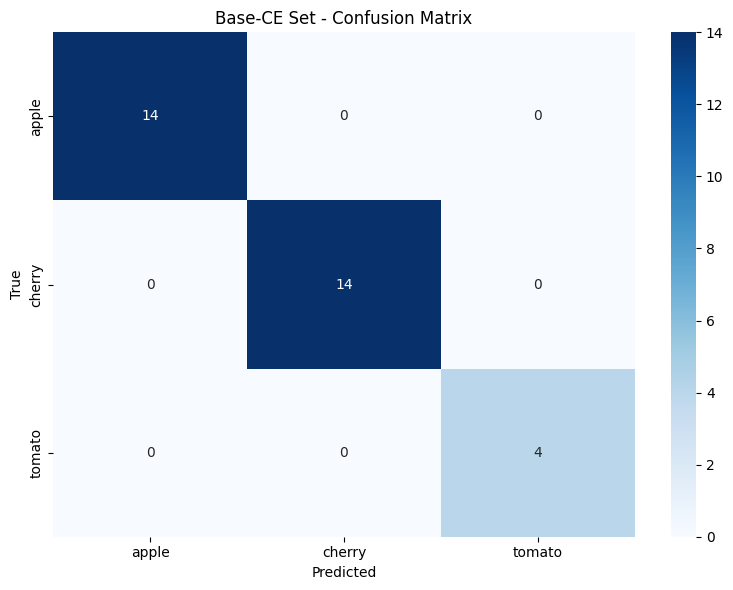


 [Base-Focal Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



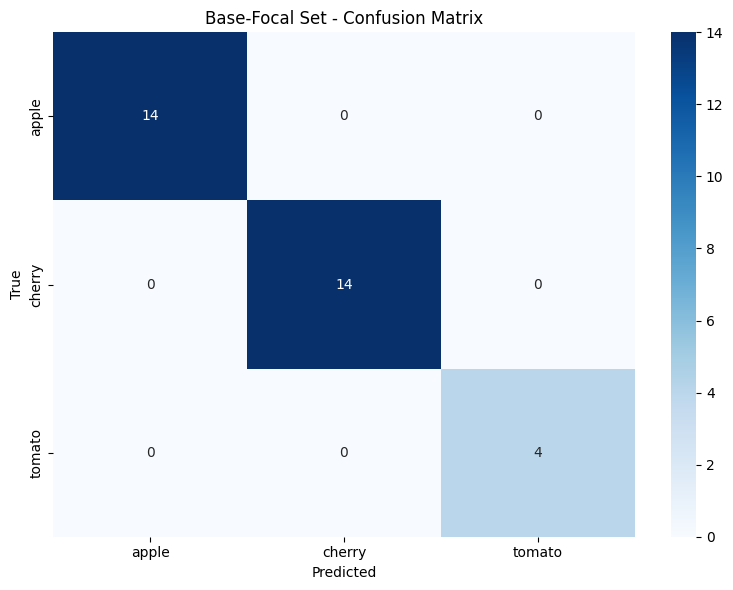


 [Adapter-CE Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



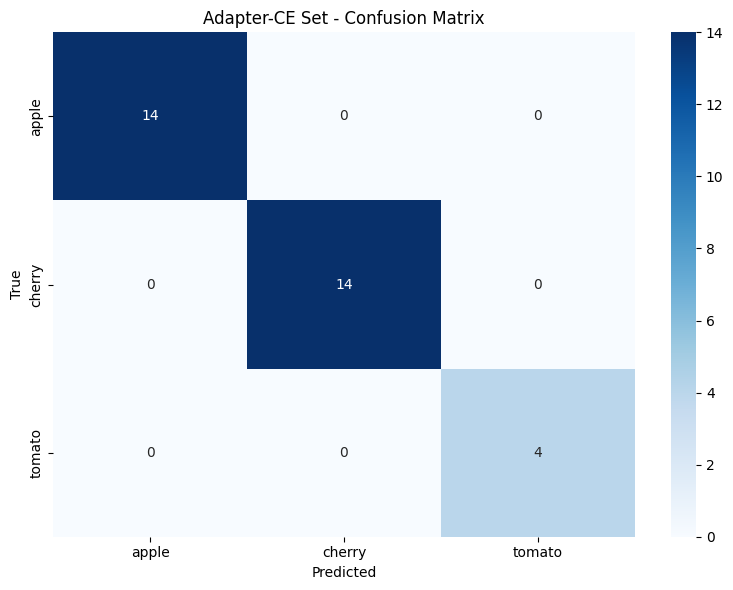


 [Adapter-Focal Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



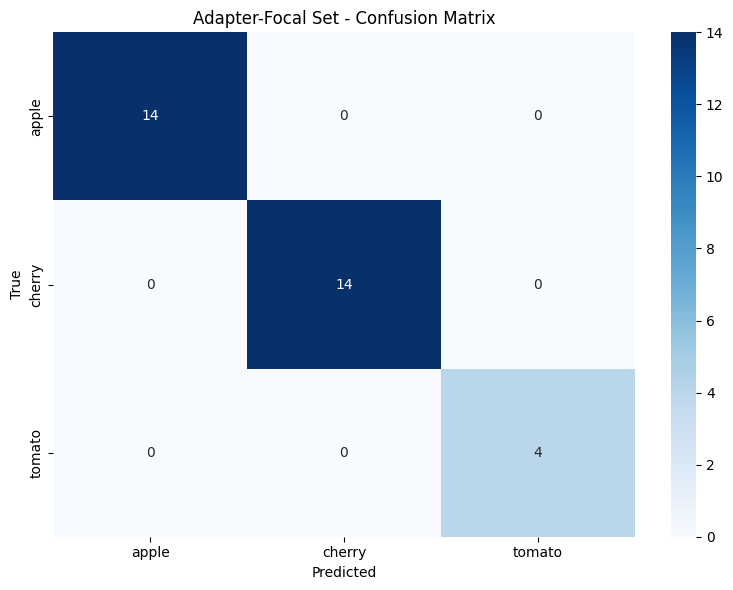

In [8]:
evaluate(model1, test_loader, title='Base-CE')
evaluate(model2, test_loader, title='Base-Focal')
evaluate(model3, test_loader, title='Adapter-CE')
evaluate(model4, test_loader, title='Adapter-Focal')

### 시각화, 전체 데이터 확인

/home/cnsi-ai/prj/grepp-ai-assignments/ai_assignments/lib/python3.12/site-packages/torch/nn/modules/module.py:1827: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


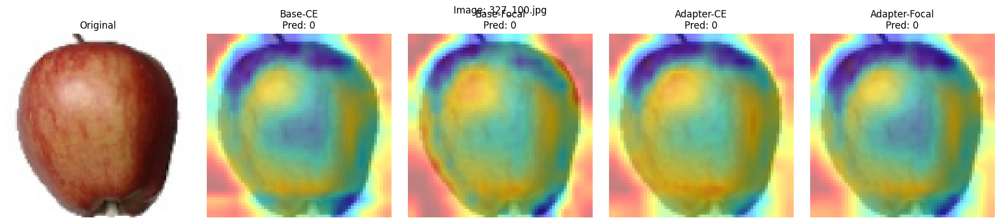

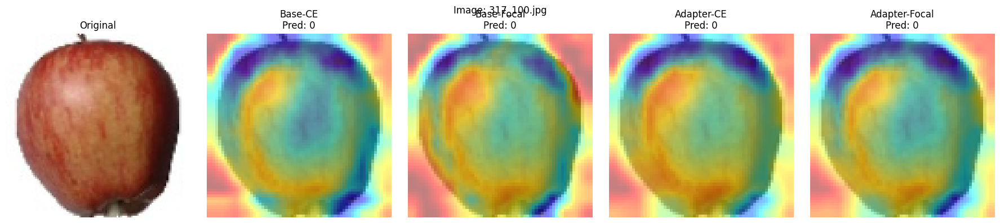

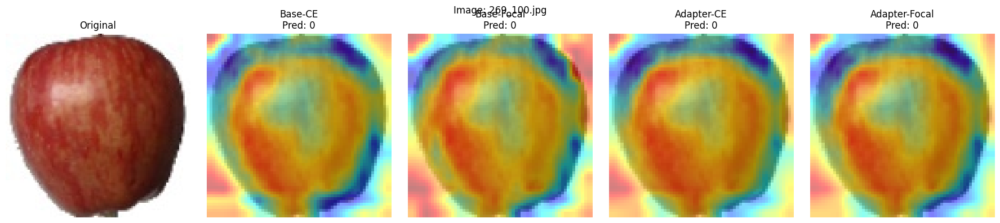

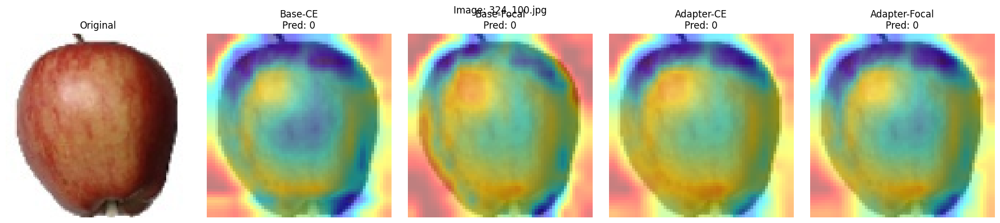

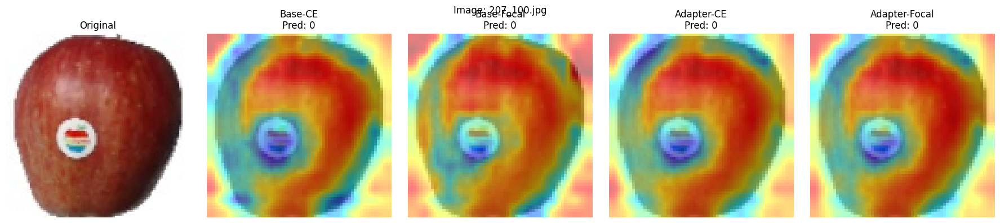

...

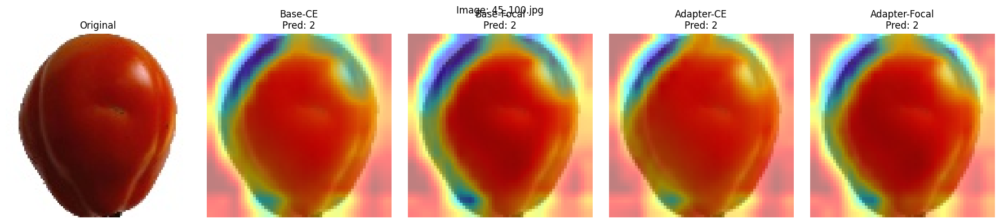

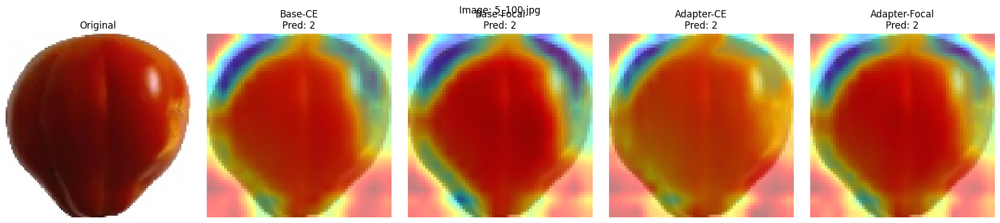

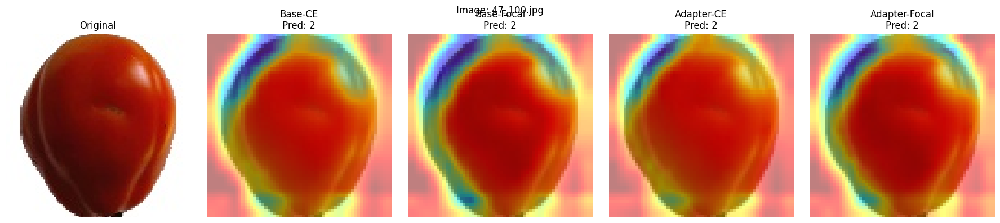

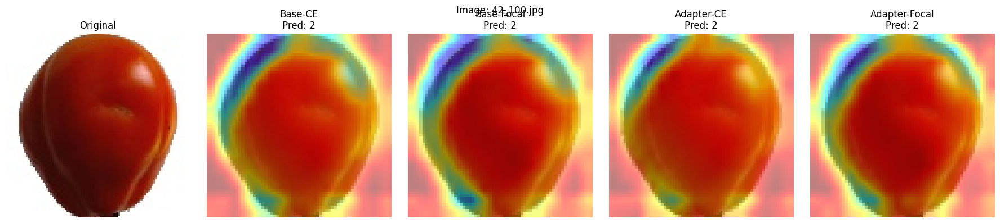

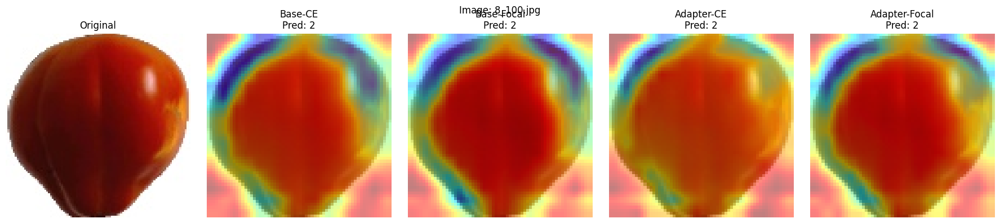

In [9]:
import os
import torch
import matplotlib.pyplot as plt
import numpy as np
import cv2
from PIL import Image
from glob import glob
from torchvision import transforms

class GradCAM:
    def __init__(self, model, target_layer, device):
        self.model = model.eval()
        self.target_layer = target_layer
        self.device = device
        self.gradients = None
        self.activations = None
        self._register_hooks()

    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.activations = output.detach()

        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0].detach()

        self.target_layer.register_forward_hook(forward_hook)
        self.target_layer.register_backward_hook(backward_hook)

    def generate(self, input_tensor, class_idx=None):
        input_tensor = input_tensor.to(self.device)
        output = self.model(input_tensor)
        if class_idx is None:
            class_idx = torch.argmax(output).item()
        self.model.zero_grad()
        output[:, class_idx].backward()
        pooled_grad = torch.mean(self.gradients, dim=(0, 2, 3))
        activation = self.activations.squeeze(0)
        for i in range(len(pooled_grad)):
            activation[i] *= pooled_grad[i]
        heatmap = torch.mean(activation, dim=0).cpu().numpy()
        heatmap = np.maximum(heatmap, 0)
        return heatmap / np.max(heatmap) if np.max(heatmap) != 0 else heatmap

# 전처리 함수
def preprocess_image(img_path):
    transform = transforms.Compose([
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406],
                             [0.229, 0.224, 0.225])
    ])
    img = Image.open(img_path).convert('RGB')
    return transform(img).unsqueeze(0), img

# 시각화 함수
def show_cam_on_image(img_pil, heatmap, alpha=0.4):
    img = np.array(img_pil.resize((64, 64))) / 255.0
    heatmap = cv2.resize(heatmap, (64, 64))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    cam_img = np.float32(heatmap_color) / 255 + img
    cam_img = cam_img / np.max(cam_img)
    return cam_img

# 데이터 경로 설정
data_root = "data/train"
categories = ["apple", "cherry", "tomato"]
image_paths = []
for cls in categories:
    image_paths.extend(glob(os.path.join(data_root, cls, "*.jpg")))

# 모델 목록
models = [model1, model2, model3, model4]
model_names = ["Base-CE", "Base-Focal", "Adapter-CE", "Adapter-Focal"]

# 장치 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 전체 이미지에 대해 Grad-CAM 생성 및 시각화
for img_path in image_paths:
    input_tensor, original_img = preprocess_image(img_path)

    fig, axs = plt.subplots(1, 5, figsize=(18, 4))
    axs[0].imshow(original_img)
    axs[0].set_title("Original")
    axs[0].axis('off')

    for i, (model, name) in enumerate(zip(models, model_names)):
        grad_cam = GradCAM(model, model.conv3, device)
        heatmap, pred_class = grad_cam.generate(input_tensor), torch.argmax(model(input_tensor.to(device))).item()
        cam_img = show_cam_on_image(original_img, heatmap)
        axs[i + 1].imshow(cam_img)
        axs[i + 1].set_title(f"{name}\nPred: {pred_class}")
        axs[i + 1].axis('off')

    plt.suptitle(f"Image: {os.path.basename(img_path)}", fontsize=12)
    plt.tight_layout()
    plt.show()


## 양자화 계획

- 학습결과와 양자화결과가 최대한 유사하도록 Quantization Aware Training 적용
- ONNX 변환을 지원하지 않는 SiLU 연산은 FP32로 유지
- 학습과 테스트는 GPU 사용, 양자화는 CPU 사용

### 양자화 모델 정의

- QAT를 위한 최종 양자화 모델 구조: QATConvNet_forConvert
- QATConvNet_forLoad으로 사전학습 가중치 로드 --> 전이학습 레이어 수정 --> QAT 전이학습 --> QATConvNet_forConvert 구조로 가중치 이식
- Linear + ReLU 와 같이 수학적으로 fusion이 가능한 레이어들은 fusion 수행

In [10]:
import torch.nn.intrinsic as nni
import torch.nn.quantized as nnq

class QATAdapterBlock(nn.Module):
    def __init__(self, in_features=64 * 8 * 8, reduction=16, num_classes=5):
        super().__init__()
        self.quant = torch.quantization.QuantStub()
        self.dequant = torch.quantization.DeQuantStub()        
        self.adapter = nn.Sequential(
            nn.Linear(in_features, in_features // reduction),
            nn.ReLU(inplace=True),
            nn.Linear(in_features // reduction, in_features),
            nn.ReLU(inplace=True)
        )
        self.classifier = nn.Linear(in_features, num_classes)

    def forward(self, x):
        x = self.quant(x)

        out = self.adapter(x)
        out = out + x
        out = self.classifier(out)

        out = self.dequant(out)
        return out

    def fuse_model(self):
        torch.quantization.fuse_modules(self.adapter, ['0', '1'], inplace=True)
        torch.quantization.fuse_modules(self.adapter, ['2', '3'], inplace=True)

class ConvBnBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1):
        super().__init__()
        self.block = nni.ConvBn2d(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(out_channels)
        )
        self.pool = nn.MaxPool2d(2)
        self.act = nn.SiLU()
        self.quant = torch.quantization.QuantStub()
        self.dequant = torch.quantization.DeQuantStub()

    def forward(self, x):
        x = self.block(x)
        x = self.dequant(x)
        x = self.act(x)
        x = self.quant(x)
        x = self.pool(x)
        return x

class QATConvNet_forConvert(nn.Module):
    def __init__(self, num_classes=5):
        super(QATConvNet_forConvert, self).__init__()
        self.quant = torch.quantization.QuantStub()
        self.dequant = torch.quantization.DeQuantStub()

        self.block1 = ConvBnBlock(3, 16)
        self.block2 = ConvBnBlock(16, 32)
        self.block3 = ConvBnBlock(32, 64)

        self.fc = nn.Linear(64 * 8 * 8, num_classes)

    def forward(self, x):
        x = self.quant(x)

        x = self.block1(x)
        x = self.block2(x)
        x = self.block3(x)

        x = x.view(x.size(0), -1)
        x = self.fc(x)

        x = self.dequant(x)
        return x

    def fuse_model(self):
        for block in [self.block1, self.block2, self.block3]:
            torch.quantization.fuse_modules(block.block, ['0', '1'], inplace=True)

        # fc가 QATAdapterBlock이면 내부 fuse 호출
        if isinstance(self.fc, QATAdapterBlock):
            self.fc.fuse_model()

class QATConvNet_forLoad(nn.Module):
    def __init__(self, num_classes=5):
        super(QATConvNet_forLoad, self).__init__()
        self.quant = torch.quantization.QuantStub()
        self.dequant = torch.quantization.DeQuantStub()

        self.conv1 = nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(16)

        self.conv2 = nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(32)

        self.conv3 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.bn3 = nn.BatchNorm2d(64)

        self.pool = nn.MaxPool2d(2)
        self.fc = nn.Linear(64 * 8 * 8, num_classes)

        self.act = nn.SiLU()

    def forward(self, x):
        x = self.quant(x)

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.dequant(x)
        x = self.act(x)
        x = self.quant(x)
        x = self.pool(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.dequant(x)
        x = self.act(x)
        x = self.quant(x)
        x = self.pool(x)

        x = self.conv3(x)
        x = self.bn3(x)
        x = self.dequant(x)
        x = self.act(x)
        x = self.quant(x)
        x = self.pool(x)

        x = x.reshape(x.size(0), -1)
        x = self.fc(x)
        x = self.dequant(x)

        return x

### QAT 학습

In [11]:
# model1: FC fine-tune + CrossEntropy
model1 = QATConvNet_forLoad(num_classes=5)
model1.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model1.conv1.parameters(): param.requires_grad = False
for param in model1.conv2.parameters(): param.requires_grad = False
for param in model1.conv3.parameters(): param.requires_grad = False
model1.fc = nn.Linear(64 * 8 * 8, num_classes)
model1.qconfig = torch.quantization.get_default_qat_qconfig('fbgemm')
torch.quantization.prepare_qat(model1, inplace=True)
model1 = train_model(model1, train_loader, val_loader, nn.CrossEntropyLoss(), strategy_name='Base-CE')

# model2: FC fine-tune + Focal Loss
model2 = QATConvNet_forLoad(num_classes=5)
model2.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model2.conv1.parameters(): param.requires_grad = False
for param in model2.conv2.parameters(): param.requires_grad = False
for param in model2.conv3.parameters(): param.requires_grad = False
model2.fc = nn.Linear(64 * 8 * 8, num_classes)
model2.qconfig = torch.quantization.get_default_qat_qconfig('fbgemm')
torch.quantization.prepare_qat(model2, inplace=True)
model2 = train_model(model2, train_loader, val_loader, FocalLoss(), strategy_name='Base-Focal')

# model3: AdapterBlock + CrossEntropy
model3 = QATConvNet_forLoad(num_classes=5)
model3.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model3.conv1.parameters(): param.requires_grad = False
for param in model3.conv2.parameters(): param.requires_grad = False
for param in model3.conv3.parameters(): param.requires_grad = False
model3.fc = QATAdapterBlock(in_features=64 * 8 * 8, reduction=16, num_classes=num_classes)
model3.qconfig = torch.quantization.get_default_qat_qconfig('fbgemm')
torch.quantization.prepare_qat(model3, inplace=True)
model3 = train_model(model3, train_loader, val_loader, nn.CrossEntropyLoss(), strategy_name='Adapter-CE')

# model4: AdapterBlock + Focal Loss
model4 = QATConvNet_forLoad(num_classes=5)
model4.load_state_dict(torch.load("conv_net.pth", map_location=device))
for param in model4.conv1.parameters(): param.requires_grad = False
for param in model4.conv2.parameters(): param.requires_grad = False
for param in model4.conv3.parameters(): param.requires_grad = False
model4.fc = QATAdapterBlock(in_features=64 * 8 * 8, reduction=16, num_classes=num_classes)
model4.qconfig = torch.quantization.get_default_qat_qconfig('fbgemm')
torch.quantization.prepare_qat(model4, inplace=True)
model4 = train_model(model4, train_loader, val_loader, FocalLoss(), strategy_name='Adapter-Focal')

/tmp/ipykernel_3141878/611446379.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model1.load_state_dict(torch.load("conv_net.pth", map_location=device))
/home/cnsi-ai/pr

[Base-CE] Epoch 1: Loss=4.0951, ValAcc=1.0000
[Base-CE] Epoch 2: Loss=2.1676, ValAcc=1.0000
[Base-CE] Epoch 3: Loss=1.3798, ValAcc=1.0000
[Base-CE] Epoch 4: Loss=0.8649, ValAcc=1.0000
[Base-CE] Epoch 5: Loss=0.5645, ValAcc=1.0000
[Base-CE] Epoch 6: Loss=0.3922, ValAcc=1.0000
[Base-CE] Epoch 7: Loss=0.2776, ValAcc=1.0000
[Base-CE] Epoch 8: Loss=0.2044, ValAcc=1.0000
[Base-CE] Epoch 9: Loss=0.1575, ValAcc=1.0000
[Base-CE] Epoch 10: Loss=0.1235, ValAcc=1.0000
[Base-CE] Epoch 11: Loss=0.0920, ValAcc=1.0000
[Base-CE] Epoch 12: Loss=0.0739, ValAcc=1.0000
[Base-CE] Epoch 13: Loss=0.0648, ValAcc=1.0000
[Base-CE] Epoch 14: Loss=0.0489, ValAcc=1.0000
[Base-CE] Epoch 15: Loss=0.0372, ValAcc=1.0000
[Base-CE] Epoch 16: Loss=0.0303, ValAcc=1.0000
[Base-CE] Epoch 17: Loss=0.0290, ValAcc=1.0000
[Base-CE] Epoch 18: Loss=0.0212, ValAcc=1.0000
[Base-CE] Epoch 19: Loss=0.0199, ValAcc=1.0000
[Base-CE] Epoch 20: Loss=0.0156, ValAcc=1.0000
[Base-Focal] Epoch 1: Loss=0.8944, ValAcc=1.0000


/tmp/ipykernel_3141878/611446379.py:14: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model2.load_state_dict(torch.load("conv_net.pth", map_location=device))


[Base-Focal] Epoch 2: Loss=0.0306, ValAcc=1.0000
[Base-Focal] Epoch 3: Loss=0.0077, ValAcc=1.0000
[Base-Focal] Epoch 4: Loss=0.0021, ValAcc=1.0000
[Base-Focal] Epoch 5: Loss=0.0006, ValAcc=1.0000
[Base-Focal] Epoch 6: Loss=0.0003, ValAcc=1.0000
[Base-Focal] Epoch 7: Loss=0.0002, ValAcc=1.0000
[Base-Focal] Epoch 8: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 9: Loss=0.0002, ValAcc=1.0000
[Base-Focal] Epoch 10: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 11: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 12: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 13: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 14: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 15: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 16: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 17: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 18: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 19: Loss=0.0001, ValAcc=1.0000
[Base-Focal] Epoch 20: Loss=0.0000, ValAcc=1.0000
[Adapter-CE] Epoch 1: Loss=3.8341, ValAcc=1.0000
[Adapter-

/tmp/ipykernel_3141878/611446379.py:25: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model3.load_state_dict(torch.load("conv_net.pth", map_location=device))


[Adapter-CE] Epoch 3: Loss=0.6696, ValAcc=1.0000
[Adapter-CE] Epoch 4: Loss=0.3194, ValAcc=1.0000
[Adapter-CE] Epoch 5: Loss=0.1413, ValAcc=1.0000
[Adapter-CE] Epoch 6: Loss=0.0587, ValAcc=1.0000
[Adapter-CE] Epoch 7: Loss=0.0238, ValAcc=1.0000
[Adapter-CE] Epoch 8: Loss=0.0095, ValAcc=1.0000
[Adapter-CE] Epoch 9: Loss=0.0040, ValAcc=1.0000
[Adapter-CE] Epoch 10: Loss=0.0017, ValAcc=1.0000
[Adapter-CE] Epoch 11: Loss=0.0009, ValAcc=1.0000
[Adapter-CE] Epoch 12: Loss=0.0004, ValAcc=1.0000
[Adapter-CE] Epoch 13: Loss=0.0003, ValAcc=1.0000
[Adapter-CE] Epoch 14: Loss=0.0002, ValAcc=1.0000
[Adapter-CE] Epoch 15: Loss=0.0001, ValAcc=1.0000
[Adapter-CE] Epoch 16: Loss=0.0001, ValAcc=1.0000
[Adapter-CE] Epoch 17: Loss=0.0001, ValAcc=1.0000
[Adapter-CE] Epoch 18: Loss=0.0001, ValAcc=1.0000
[Adapter-CE] Epoch 19: Loss=0.0001, ValAcc=1.0000
[Adapter-CE] Epoch 20: Loss=0.0000, ValAcc=1.0000


/tmp/ipykernel_3141878/611446379.py:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model4.load_state_dict(torch.load("conv_net.pth", map_location=device))


[Adapter-Focal] Epoch 1: Loss=0.6833, ValAcc=1.0000
[Adapter-Focal] Epoch 2: Loss=0.0487, ValAcc=1.0000
[Adapter-Focal] Epoch 3: Loss=0.0098, ValAcc=1.0000
[Adapter-Focal] Epoch 4: Loss=0.0013, ValAcc=1.0000
[Adapter-Focal] Epoch 5: Loss=0.0001, ValAcc=1.0000
[Adapter-Focal] Epoch 6: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 7: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 8: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 9: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 10: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 11: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 12: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 13: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 14: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 15: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 16: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 17: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 18: Loss=0.0000, ValAcc=1.0000
[Adapter-Focal] Epoch 19: Loss=0.0000, ValAcc=1.0000
[A

### QAT 모델 평가


 [Base-CE Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



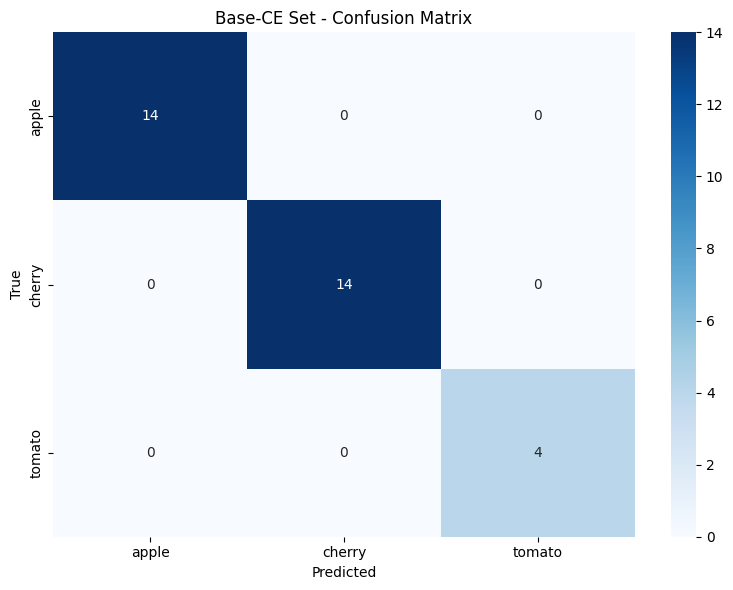


 [Base-Focal Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



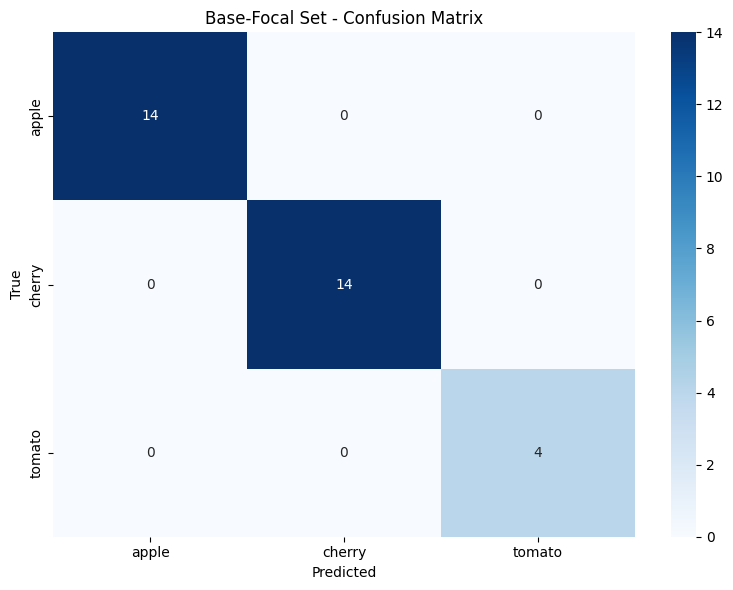


 [Adapter-CE Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



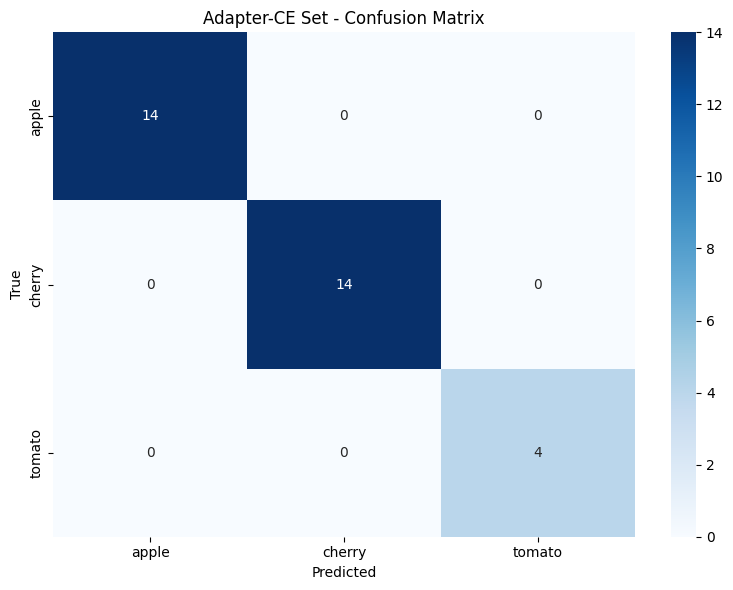


 [Adapter-Focal Set Evaluation]
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        14
      cherry       1.00      1.00      1.00        14
      tomato       1.00      1.00      1.00         4

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



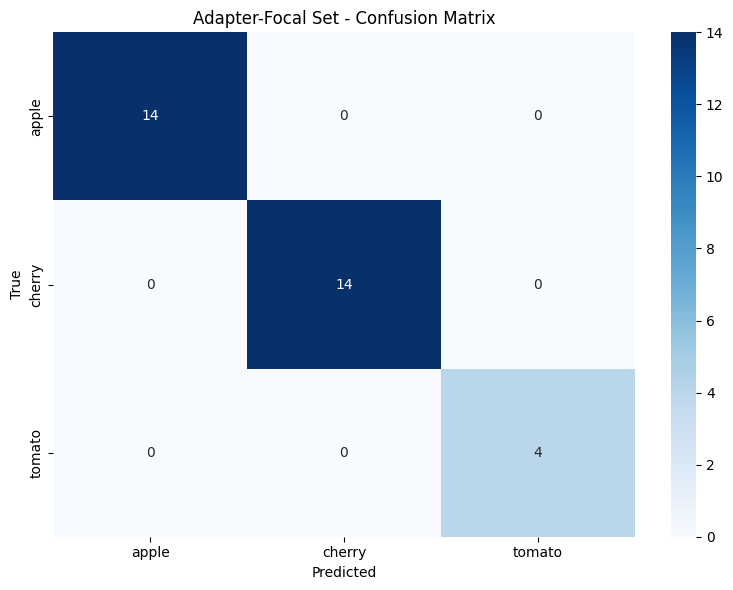

In [12]:
evaluate(model1, test_loader, title='Base-CE')
evaluate(model2, test_loader, title='Base-Focal')
evaluate(model3, test_loader, title='Adapter-CE')
evaluate(model4, test_loader, title='Adapter-Focal')

### 최종 양자화 모델에 이식, 양자화(torch.quantization.convert), ONNX로 변환

In [13]:
models = [model1, model2, model3, model4]
model_names = ["Base-CE", "Base-Focal", "Adapter-CE", "Adapter-Focal"]

input_shape = (1, 3, 64, 64)
for model, name in zip(models, model_names):
    #print(f"--- Model Name: {name} ---")
    # Grad-CAM을 위해 연결된 훅 제거
    for _, module in model.named_modules():
        if hasattr(module, "_forward_hooks") and module._forward_hooks:
            module._forward_hooks.clear()

    #print("Original model:")
    #print(model)
    #state_dict = model.state_dict()

    model_forConvert = QATConvNet_forConvert(num_classes=3)

    if name == "Adapter-CE" or name == "Adapter-Focal":
        model_forConvert.fc = QATAdapterBlock(
            in_features=64 * 8 * 8,
            reduction=16,
            num_classes=3
        )
    
    source_sd = model.state_dict()
    target_sd = model_forConvert.state_dict()

    mapped_sd = {}

    for key in target_sd:
        # Conv-BN 매핑
        if 'block1.block.0' in key:
            source_key = key.replace('block1.block.0', 'conv1')
        elif 'block1.block.1' in key:
            source_key = key.replace('block1.block.1', 'bn1')
        elif 'block2.block.0' in key:
            source_key = key.replace('block2.block.0', 'conv2')
        elif 'block2.block.1' in key:
            source_key = key.replace('block2.block.1', 'bn2')
        elif 'block3.block.0' in key:
            source_key = key.replace('block3.block.0', 'conv3')
        elif 'block3.block.1' in key:
            source_key = key.replace('block3.block.1', 'bn3')
    
        # AdapterBlock에 해당하는 키들 복사
        elif key.startswith("fc.adapter.") or key.startswith("fc.classifier.") or \
             key.startswith("fc.quant") or key.startswith("fc.dequant"):
            source_key = key
    
        else:
            source_key = key
    
        if source_key in source_sd:
            mapped_sd[key] = source_sd[source_key]
        else:
            print(f"누락된 키: {source_key} ← (대상: {key})")

    model_forConvert.load_state_dict(mapped_sd, strict=False)
    #print("\nModel for Convert:")
    #print(model_forConvert)

    model_forConvert.eval()    
    model_forConvert.fuse_model()
    model_forConvert.cpu()
    model_converted = torch.quantization.convert(model_forConvert, inplace=False)
    dummy_input = torch.randn(input_shape)

    onnx_file = f"qat_model_{name}_int8.onnx"
    torch.onnx.export(
        model_converted,
        dummy_input,
        onnx_file,
        input_names=['input'],
        output_names=['output'],
        opset_version=13,
        do_constant_folding=True,
        dynamic_axes={'input': {0: 'batch_size'}, 'output': {0: 'batch_size'}}
    )

### ONNX 테스트


 Classification Report
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00       127
      cherry       1.00      1.00      1.00       127
      tomato       1.00      1.00      1.00        50

    accuracy                           1.00       304
   macro avg       1.00      1.00      1.00       304
weighted avg       1.00      1.00      1.00       304



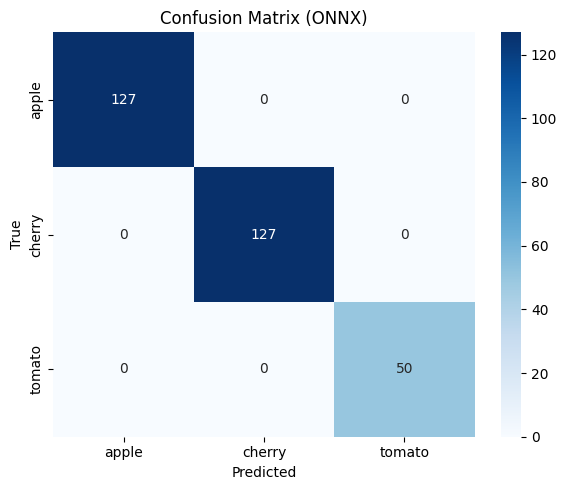


 Classification Report
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00       127
      cherry       1.00      1.00      1.00       127
      tomato       1.00      1.00      1.00        50

    accuracy                           1.00       304
   macro avg       1.00      1.00      1.00       304
weighted avg       1.00      1.00      1.00       304



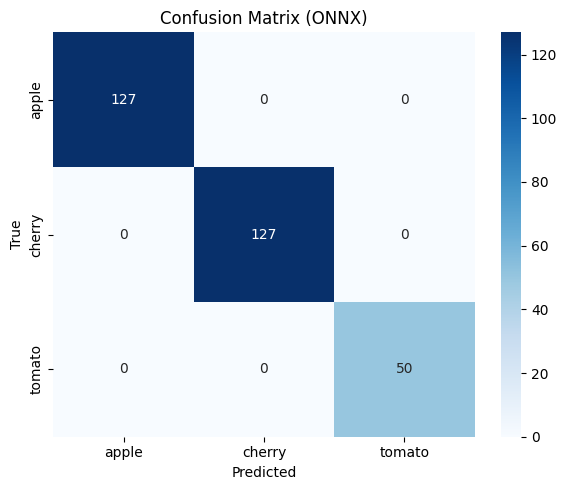


 Classification Report
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00       127
      cherry       1.00      1.00      1.00       127
      tomato       1.00      1.00      1.00        50

    accuracy                           1.00       304
   macro avg       1.00      1.00      1.00       304
weighted avg       1.00      1.00      1.00       304



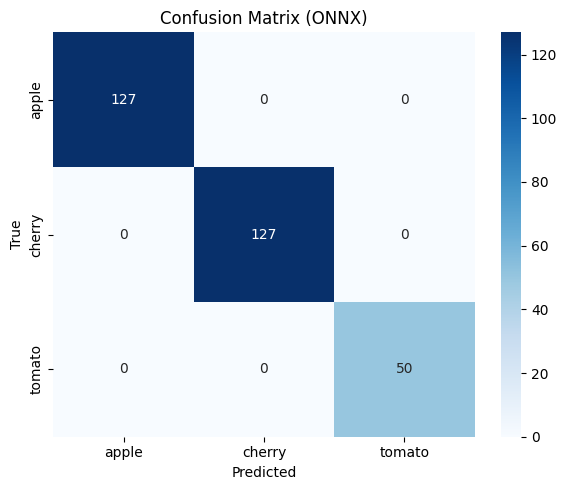


 Classification Report
              precision    recall  f1-score   support

       apple       1.00      1.00      1.00       127
      cherry       1.00      1.00      1.00       127
      tomato       1.00      1.00      1.00        50

    accuracy                           1.00       304
   macro avg       1.00      1.00      1.00       304
weighted avg       1.00      1.00      1.00       304



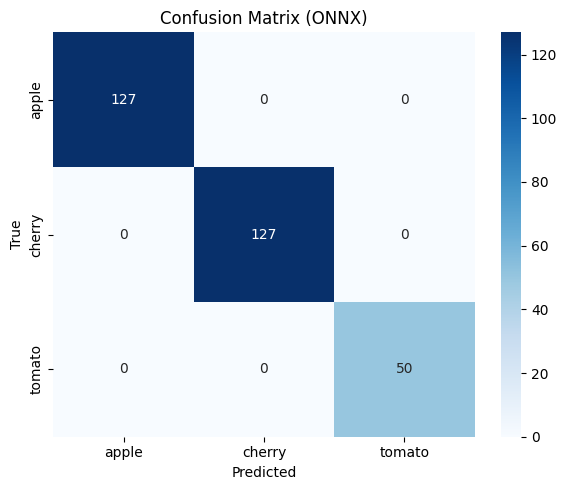

In [14]:
import onnxruntime as ort
from torchvision import transforms
from glob import glob
import numpy as np

model_names = ["Base-CE", "Base-Focal", "Adapter-CE", "Adapter-Focal"]
data_root = "data/train"
categories = ["apple", "cherry", "tomato"]
image_paths = []
for cls in categories:
    image_paths.extend(glob(os.path.join(data_root, cls, "*.jpg")))

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

def classify_image_tensor(image_tensor, input_name, output_name):
    image_np = image_tensor.unsqueeze(0).numpy()
    outputs = session.run([output_name], {input_name: image_np})
    pred_logits = outputs[0]
    pred_class_idx = np.argmax(pred_logits, axis=1)[0]
    return pred_class_idx

def evaluate_onnx_model(test_loader, input_name, output_name):
    y_true = []
    y_pred = []

    for images, labels in test_loader:
        for img_tensor, label in zip(images, labels):
            pred = classify_image_tensor(img_tensor, input_name, output_name)
            y_true.append(label.item())
            y_pred.append(pred)

    print("\n Classification Report")
    print(classification_report(y_true, y_pred, target_names=class_names))

    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix (ONNX)')
    plt.tight_layout()
    plt.show()

for name in model_names:
    onnx_file = f"qat_model_{name}_int8.onnx"

    sess_options = ort.SessionOptions()
    sess_options.graph_optimization_level = ort.GraphOptimizationLevel.ORT_ENABLE_ALL

    session = ort.InferenceSession(onnx_file, providers=['CPUExecutionProvider'])
    input_name = session.get_inputs()[0].name
    output_name = session.get_outputs()[0].name
    
    test_data = datasets.ImageFolder(root="data/train", transform=transform)
    test_loader = DataLoader(test_data, batch_size=1, shuffle=False)
    evaluate_onnx_model(test_loader, input_name, output_name)